# Imports

In [1]:
%matplotlib inline

import os
import json

import PIL
import cv2
import albumentations as A

import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
plt.rcParams.update({'figure.max_open_warning': 0})

from tqdm import tqdm

from itertools import zip_longest

# Utils

In [2]:
from utils import (
    get_images_metainfo,
    display_multiple_img,
    check_images_corruption_v2 as check_images_corruption
)

# Constants

In [3]:
data_path = os.path.join('dataset', 'Medical mask', 'Medical Mask')

images_path = os.path.join(data_path, 'images')
annotations_path = os.path.join(data_path, 'annotations')

# Exploratory Data Analysis

We need to explore our data so we can gain additional knowledge about the data. Also, we need to be sure that there are no corrupted images, corrupted annotations, and look for class imbalance in labels.


## Images
First, we start with visualization of the images from dataset.

Get number of images in dataset:

In [4]:
images_list = np.array(os.listdir(images_path))
print(f'Images in dataset: {images_list.shape[0]}')

Images in dataset: 6024


Pick random K samples from dataset

In [5]:
images_indices = np.arange(images_list.shape[0], dtype='int')
np.random.shuffle(images_indices)

Visualize images

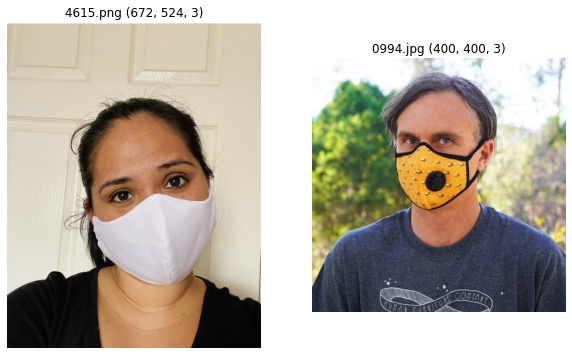

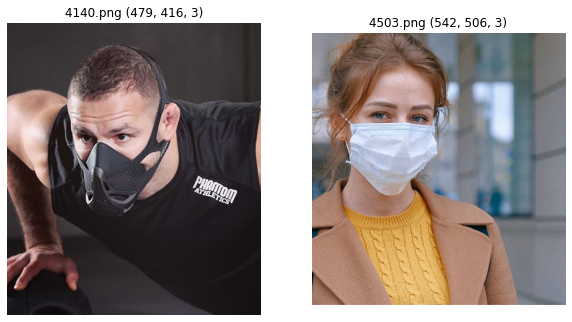

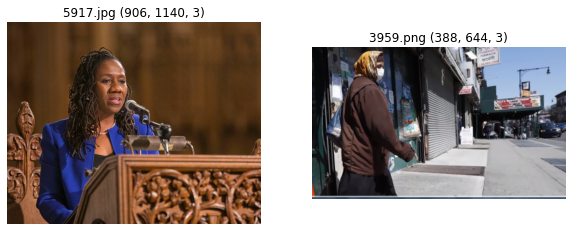

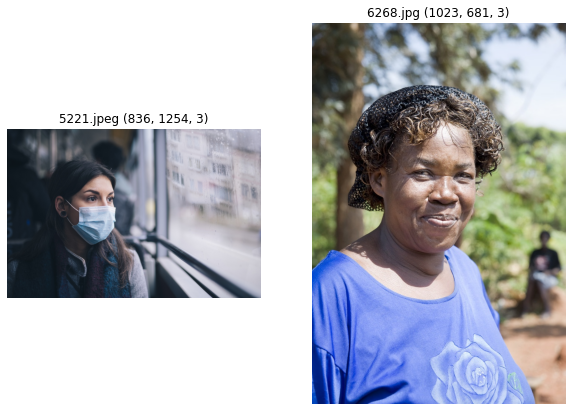

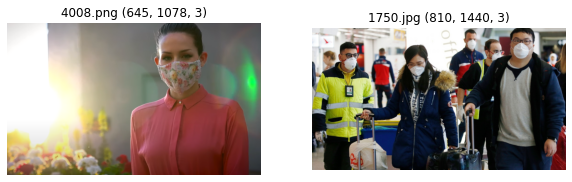

...

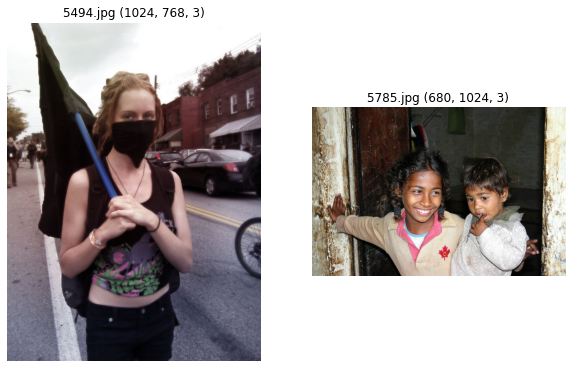

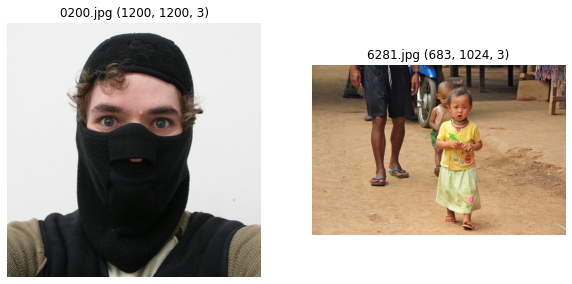

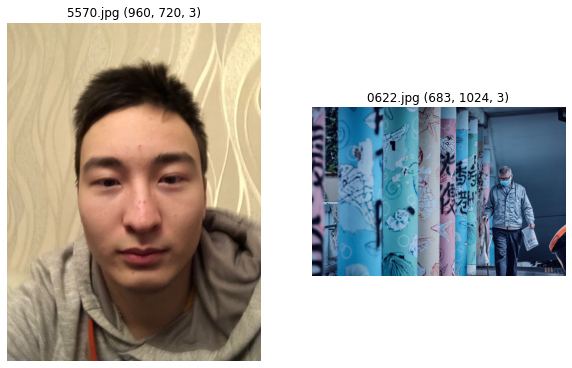

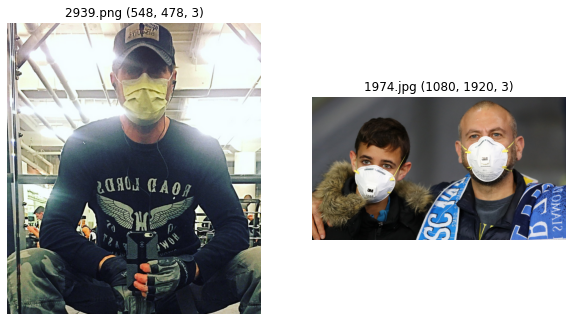

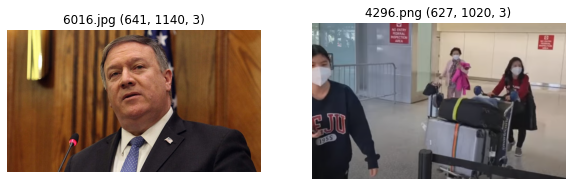

In [6]:
k = 50
first_k_images = images_list[images_indices][:k]

display_multiple_img(
    images=first_k_images,
    images_path=images_path,
    cols=2
)

check if all images are readable and not corrupted

In [7]:
errors_df = pd.DataFrame(check_images_corruption(
    images_list=images_list,
    images_path=images_path
))

errors_df[['shape_error', 'corrupted']].dropna().shape

100%|██████████| 6024/6024 [14:49<00:00,  6.77it/s]


(0, 2)

read metainfo of the images

In [8]:
metainfo = get_images_metainfo(
    images_list=images_list,
    images_path=images_path
)

metainfo_df = pd.DataFrame(metainfo)
metainfo_df

100%|██████████| 6024/6024 [00:00<00:00, 11092.82it/s]


,imagename,width,height,aspect_ratio
0,5117.jpg,620,389,1.593830
1,3955.png,707,611,1.157119
2,5229.jpg,640,420,1.523810
3,5280.jpg,862,575,1.499130
4,1035.jpeg,622,380,1.636842
...,...,...,...,...
6019,0306.jpg,615,409,1.503667
6020,0009.jpg,2048,1365,1.500366
6021,1423.jpg,1000,563,1.776199
6022,1260.jpg,750,500,1.500000


inspect images sizes and aspect ratios

In [9]:
metainfo_df.describe()

,width,height,aspect_ratio
count,6024.000000,6024.000000,6024.000000
mean,920.320385,744.895916,1.296076
std,609.661663,542.516477,0.373643
min,306.000000,269.000000,0.441406
25%,640.000000,526.000000,1.000000
50%,754.000000,611.000000,1.333333
75%,1024.000000,745.000000,1.502347
max,6720.000000,8192.000000,2.936027


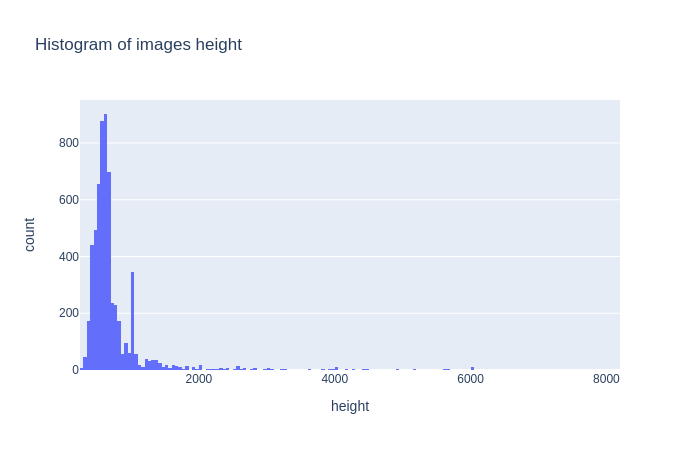

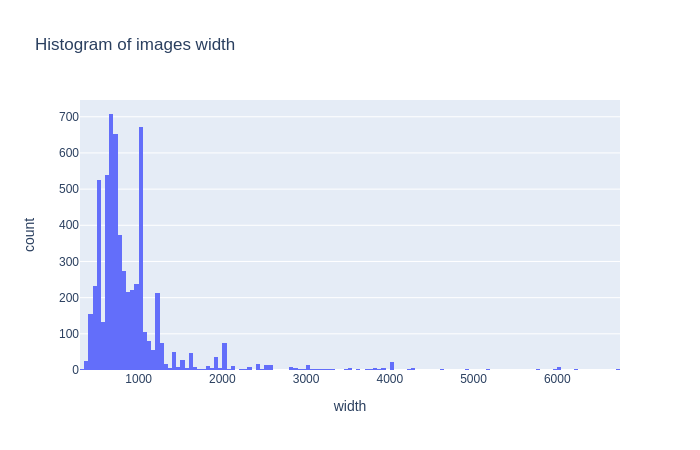

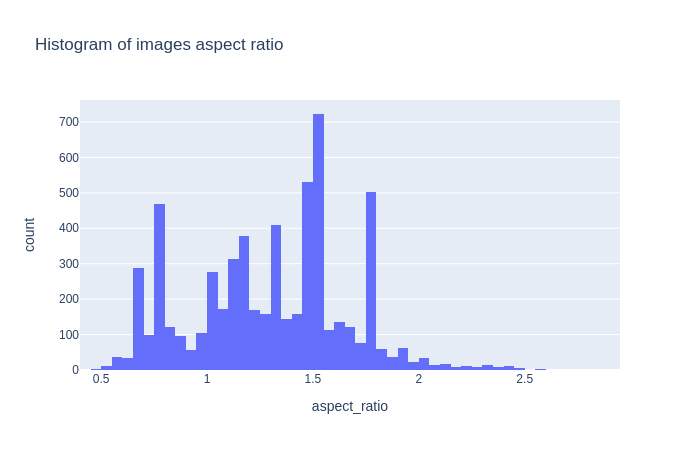

In [10]:
fig1 = px.histogram(metainfo_df, x='height', title='Histogram of images height')
fig1.show('png')
fig2 = px.histogram(metainfo_df, x='width', title='Histogram of images width')
fig2.show('png')
fig3 = px.histogram(metainfo_df, x='aspect_ratio', title='Histogram of images aspect ratio')
fig3.show('png')

From that point we can already say that this dataset:


1.   Consist of images with a variety in an aspect ratio
2.   No corrupted images was found yet



## Annotations
The second step is to inspect and analyze dataset annotations.

The first thing we need here is to read annotations.

In [11]:
dataset = []

for imagename in images_list:
    with open(os.path.join(annotations_path, imagename + '.json')) as json_file:
        data = json.load(json_file)

        for anno in data['Annotations']:
            dataset.append({
                'filename': imagename,
                **anno
            })

dataset_df = pd.DataFrame(dataset)
dataset_df

,filename,isProtected,ID,BoundingBox,classname,Confidence,Attributes
0,5117.jpg,False,125546373797512096,"[144, 117, 245, 219]",face_with_mask,1,{}
1,5117.jpg,False,904898972412042368,"[171, 175, 238, 216]",mask_colorful,1,{}
2,5117.jpg,False,668841163673858304,"[140, 119, 251, 185]",hat,1,{}
3,5117.jpg,False,490664019171652608,"[175, 158, 238, 187]",sunglasses,1,{}
4,3955.png,False,432581138148389056,"[100, 6, 658, 610]",face_with_mask,1,{}
...,...,...,...,...,...,...,...
23549,1260.jpg,False,270471370652380256,"[220, 144, 281, 193]",mask_colorful,1,{}
23550,1260.jpg,False,708003478896537472,"[213, 94, 279, 196]",hijab_niqab,1,{}
23551,5336.jpg,False,396169474796939840,"[156, 15, 360, 100]",hat,1,{}
23552,5336.jpg,False,101962093834252368,"[210, 65, 303, 149]",face_other_covering,1,{}


How much annotations per image we have in the dataset?

In [12]:
dataset_df.groupby('filename')['BoundingBox'].count().mean()

3.9100265604249667

How much samples per category we have in the dataset?

['face_with_mask' 'mask_colorful' 'hat' 'sunglasses' 'mask_surgical'
 'face_other_covering' 'face_no_mask' 'eyeglasses' 'turban' 'face_shield'
 'other' 'hair_net' 'scarf_bandana' 'face_with_mask_incorrect'
 'hijab_niqab' 'goggles' 'helmet' 'hood' 'balaclava_ski_mask' 'gas_mask']


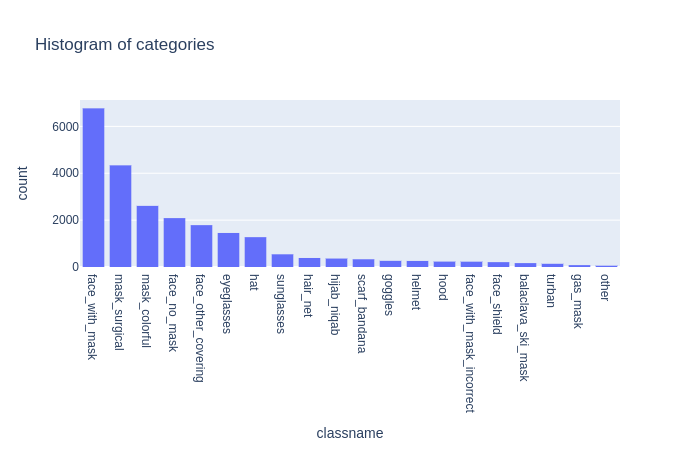

In [13]:
print(dataset_df['classname'].unique())
fig = px.histogram(dataset_df, x='classname', title='Histogram of categories')
fig.update_xaxes(categoryorder='total descending')
fig.show('png')

Ideally, we want to see uniform distribution here, but that's never happening in real life. So we can see that 3 - 5 categories have a strong appearance in the dataset and will contribute a lot in the training process while other categories will underperform and some of them will probably close to 0.

What is the area of the boxes we have in the dataset?

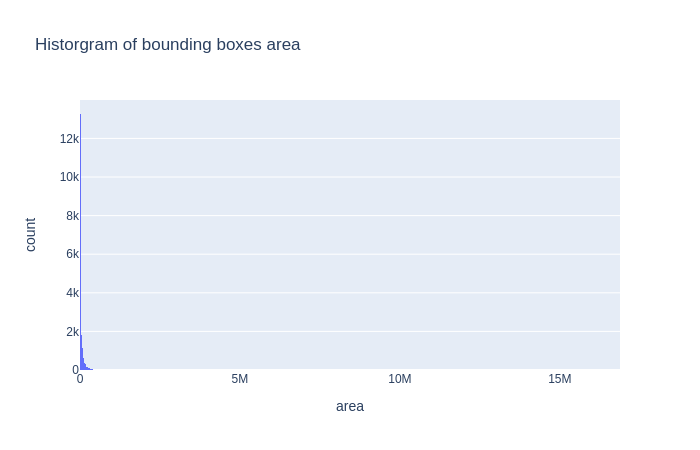

In [14]:
dataset_df['area'] = dataset_df['BoundingBox'].apply(lambda x: (x[2] - x[0]) * (x[3] - x[1]))
fig = px.histogram(dataset_df, x='area', title='Historgram of bounding boxes area')
fig.show('png')

In [17]:
dataset_df['area'].describe()

count    2.355400e+04
mean     6.827213e+04
std      3.457262e+05
min      0.000000e+00
25%      4.060000e+03
50%      1.447500e+04
75%      5.350050e+04
max      1.686820e+07
Name: area, dtype: float64

As we can see there are high-resolution images that prevent us from getting the right visualization of the boxes area. 

Add some filters on the data to get better visualization:

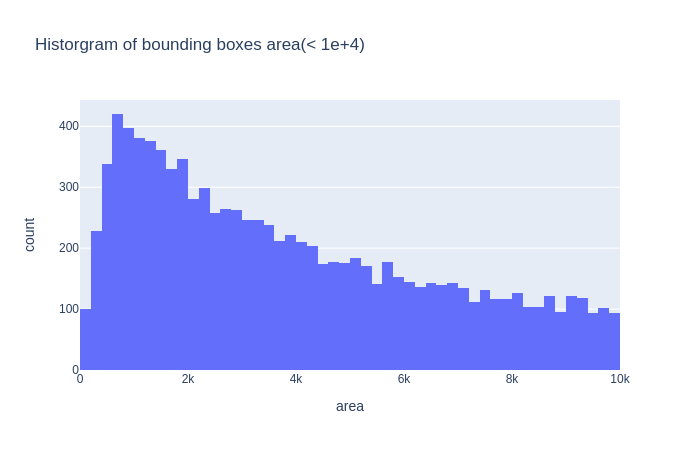

In [16]:
fig = px.histogram(dataset_df[dataset_df['area'] < 1e+4], x='area', title='Historgram of bounding boxes area(< 1e+4)')
fig.show('png')

There is a lot of boxes with a low area which can hurt learning of the object detection algorithm, so we can apply multiple approaches to solve this problem:



1.   Resize images keeping aspect ratio so we can get bigger boxes on the small images
2.   Drop all boxes that are lesser than AREA(32px\*32px lowest anchor in the pre-trained object detectors on COCO dataset, for Google AutoML Vision the lowest value is 8px\*8px)
3.   Split images into multiple parts to get bigger objects

Visualization of mean area per category

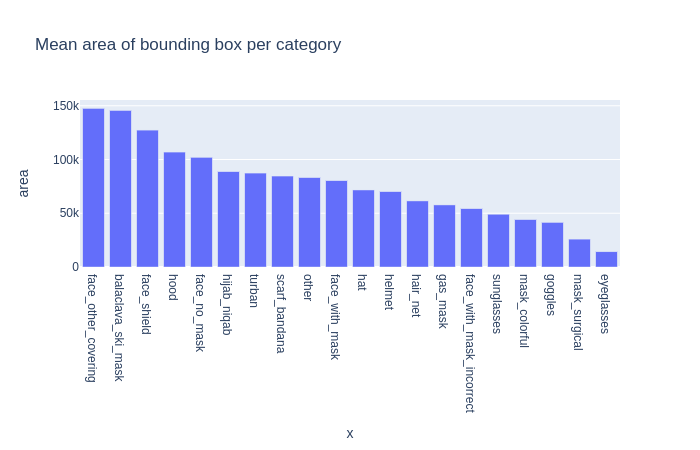

In [18]:
agg_by_classname = dataset_df.groupby('classname')['area',].mean()

fig = px.bar(
    agg_by_classname,
    x=agg_by_classname.index, 
    y='area',
    title='Mean area of bounding box per category' 
)
fig.update_xaxes(categoryorder='total descending')
fig.show('png')

Visualize aspect ratio for bounding boxes in the annotations

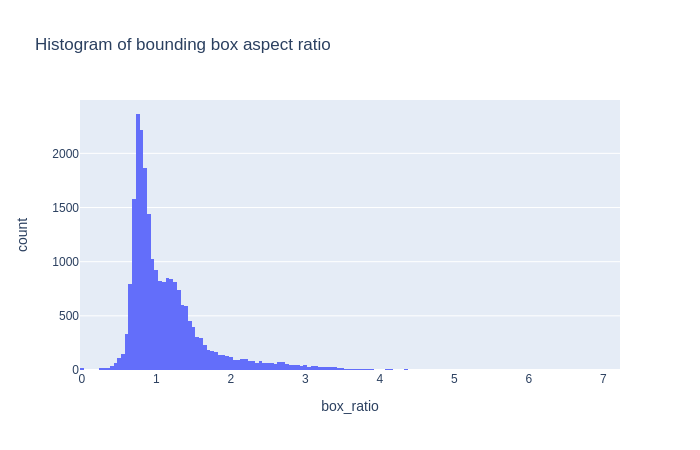

In [19]:
def count_box_ratio(x):
    try:
        return (x[2] - x[0]) / (x[3] - x[1])
    except ZeroDivisionError as e:
        return 0

dataset_df['box_ratio'] = dataset_df['BoundingBox'].apply(count_box_ratio)
fig = px.histogram(dataset_df, x='box_ratio', title='Histogram of bounding box aspect ratio')
fig.show('png')

## Visualize dataset annotations

Visualize all annotations

In [ ]:
def grouper(iterable, n, fillvalue=None):
    """Collect data into fixed-length chunks or blocks"""
    
    args = [iter(iterable)] * n
    return zip_longest(*args, fillvalue=fillvalue)

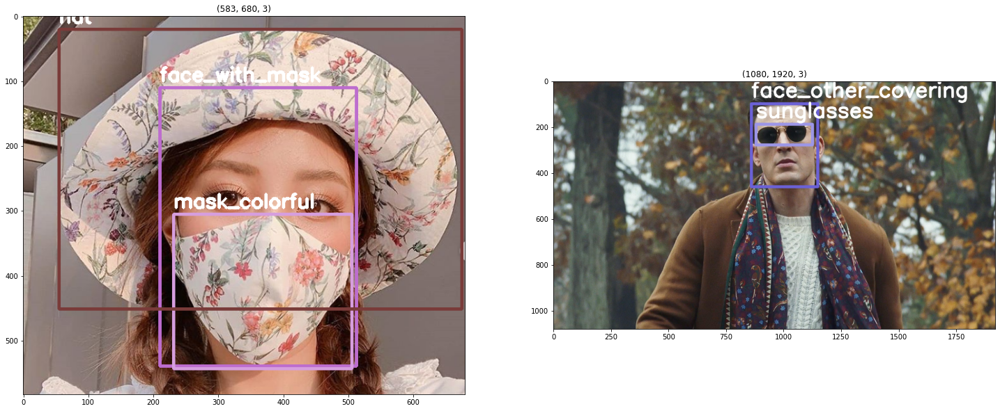

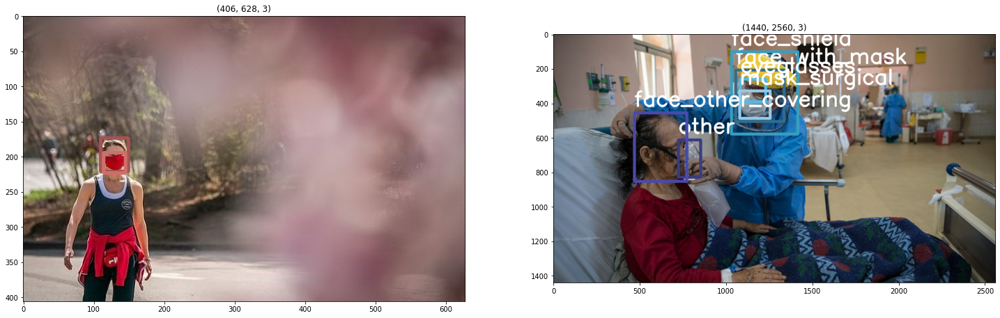

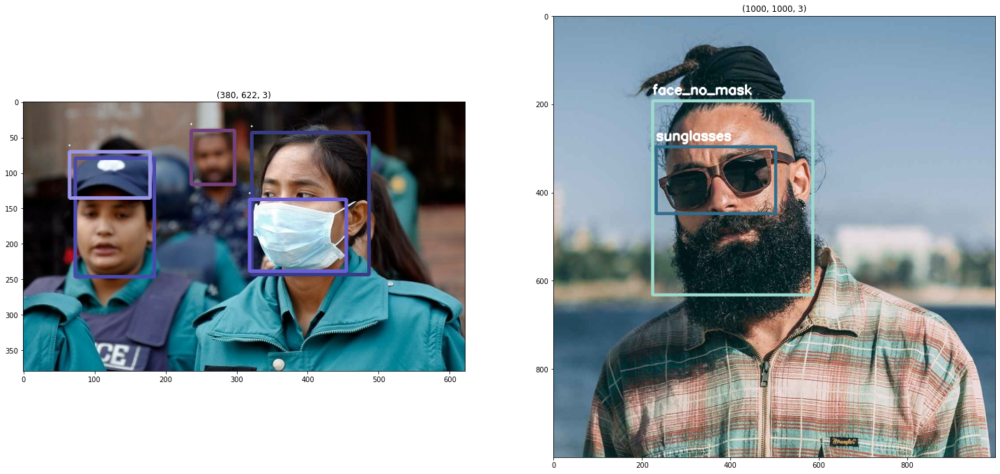

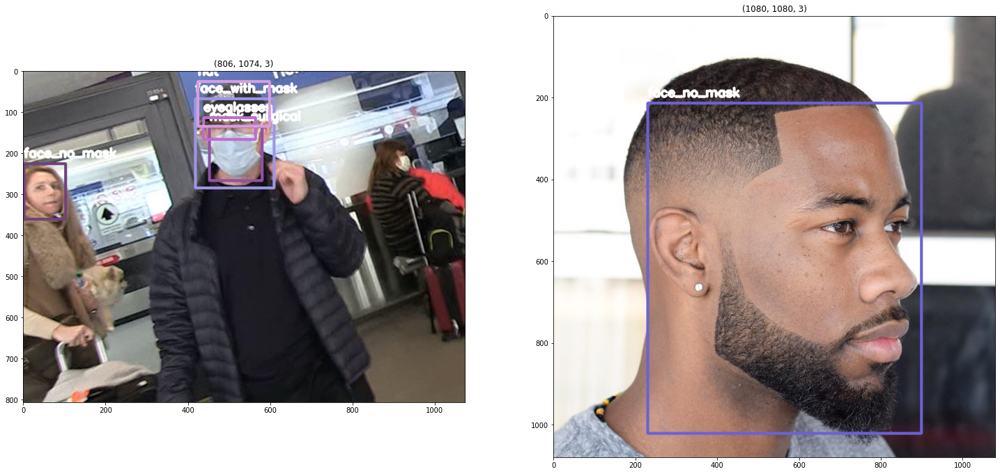

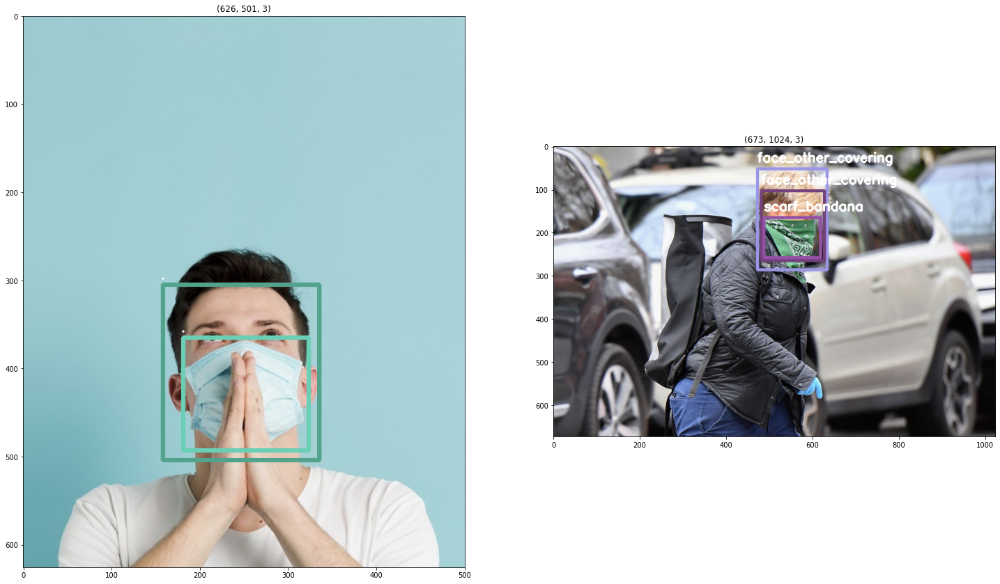

...

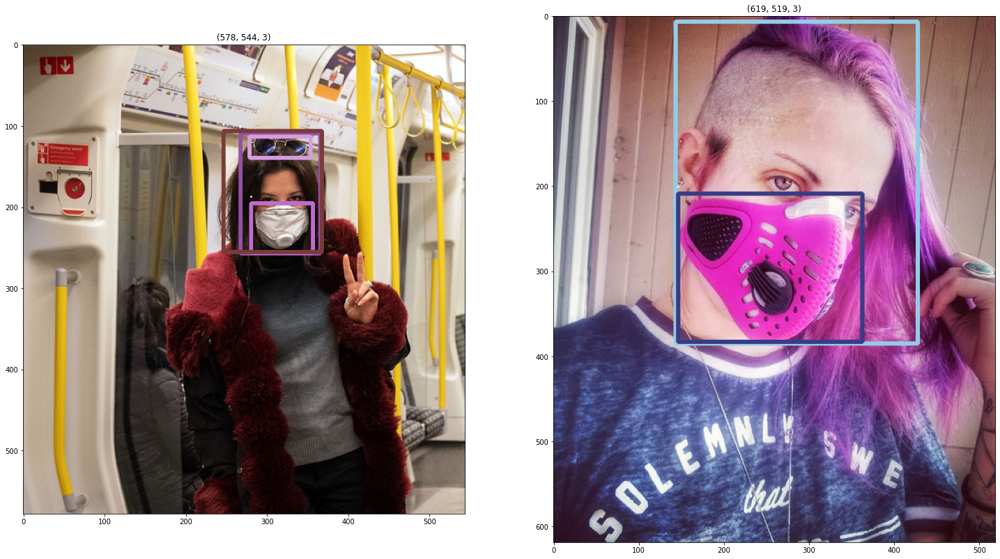

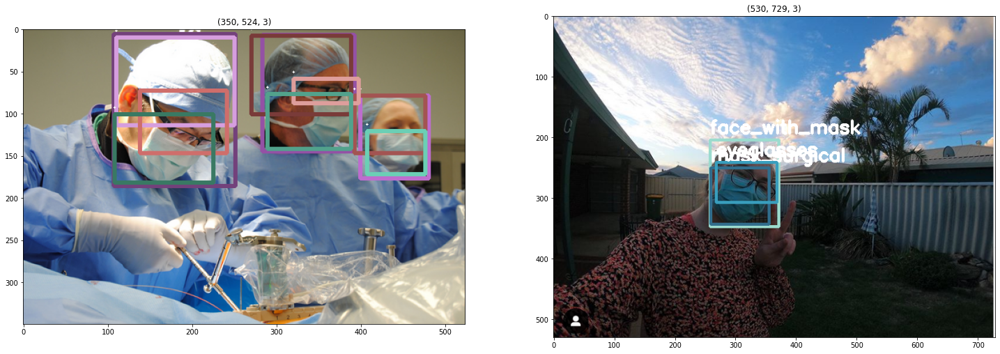

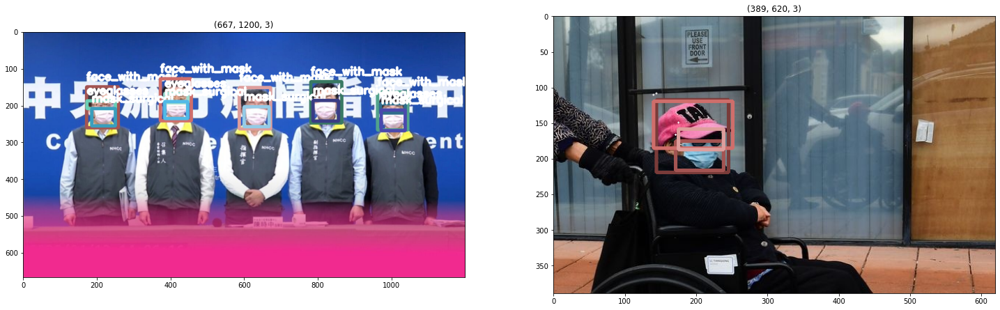

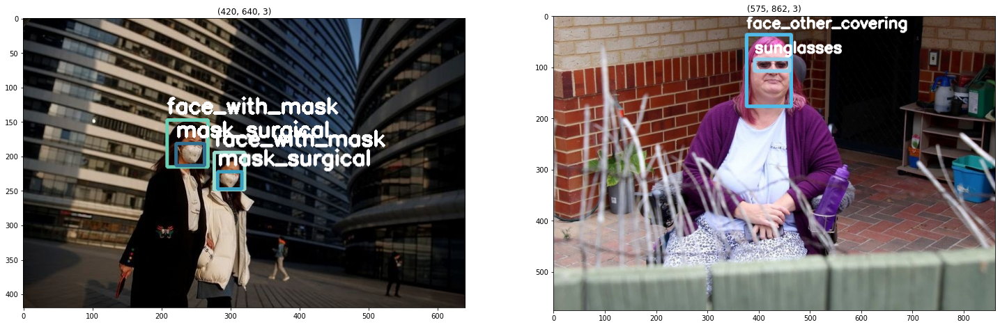

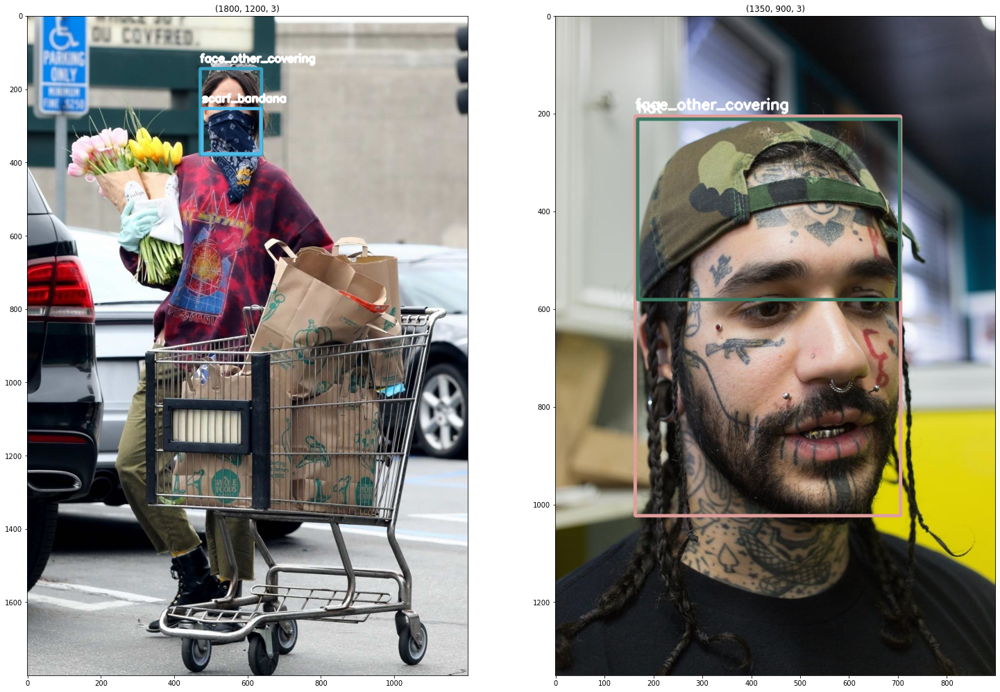

In [ ]:
cols = 2
limit = 100

cmap = plt.get_cmap('tab20b')
colors = [cmap(i) for i in np.linspace(0, 1, 20)]

dataset_grouped = grouper(dataset_df[:limit].groupby('filename'), n=2)

for _, grouped_pairs in enumerate(dataset_grouped):
    figure, ax = plt.subplots(nrows = 1, ncols = cols, figsize = (25, 25))

    for ind, current_sample in enumerate(grouped_pairs):
        if not current_sample:
            break
        
        (imagename, sample) = current_sample
        image = cv2.imread(
            os.path.join(images_path, imagename)
        )

        for i, row in sample.iterrows():
            color = colors[int(i) % len(colors)]
            color = [i * 255 for i in color]
            
            coordinates = [
                (row['BoundingBox'][0], row['BoundingBox'][1]),
                (row['BoundingBox'][2], row['BoundingBox'][3]),
            ]
                          
            cv2.rectangle(image, coordinates[0], coordinates[1], color, int(4*image.shape[1]/640))
            cv2.putText(image, row['classname'], 
                        (coordinates[0][0], coordinates[0][1] - int(10*image.shape[1]/640)), cv2.FONT_HERSHEY_SIMPLEX, 
                        int(1*image.shape[1]/640), (255,255,255), int(3*image.shape[1]/640))

        ax[ind].set_title(image.shape)
        ax[ind].imshow(image[:,:,::-1])

Visualize small objects

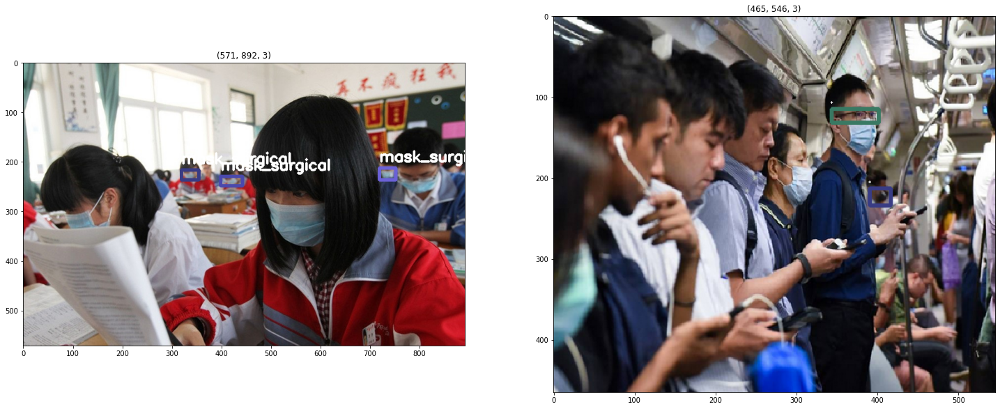

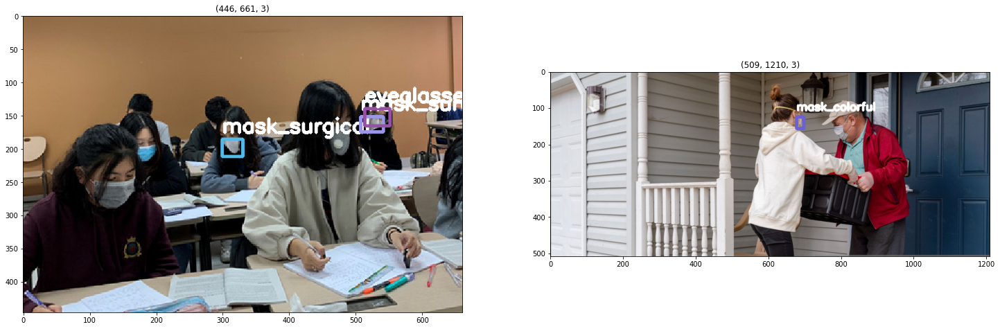

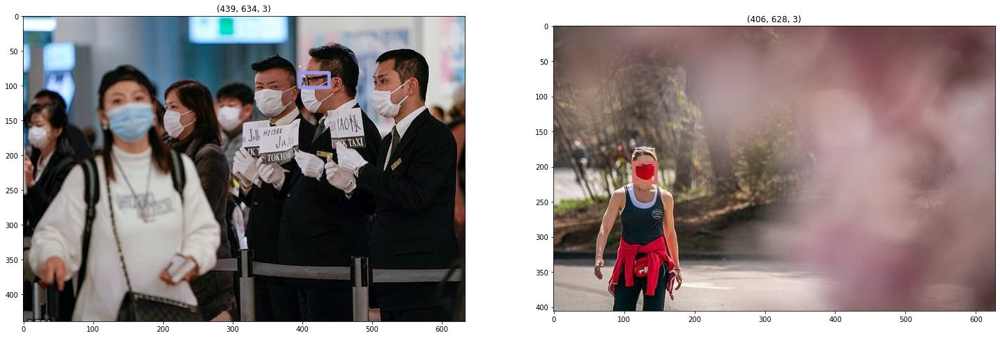

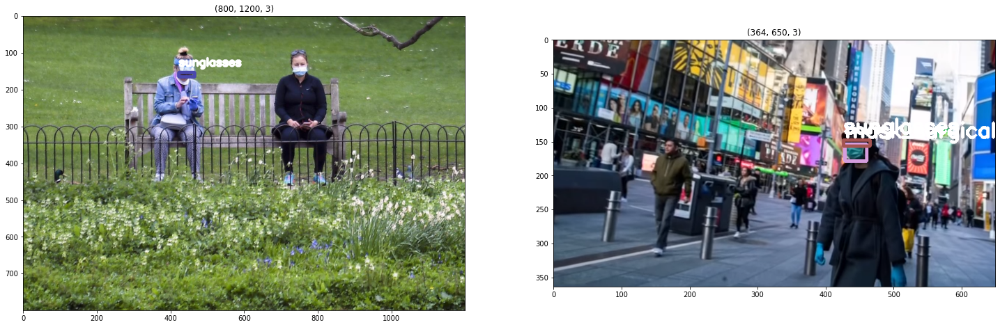

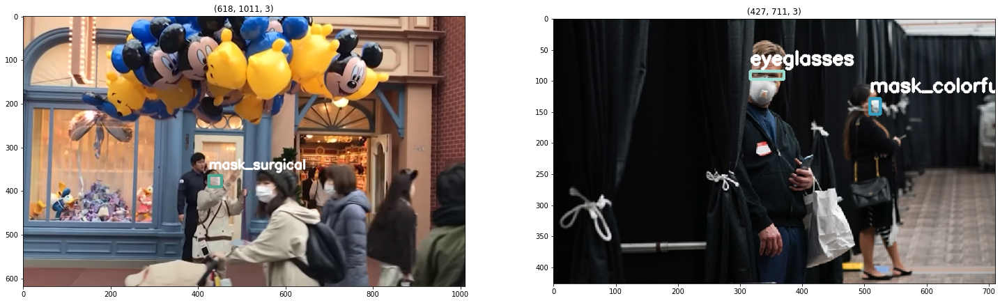

...

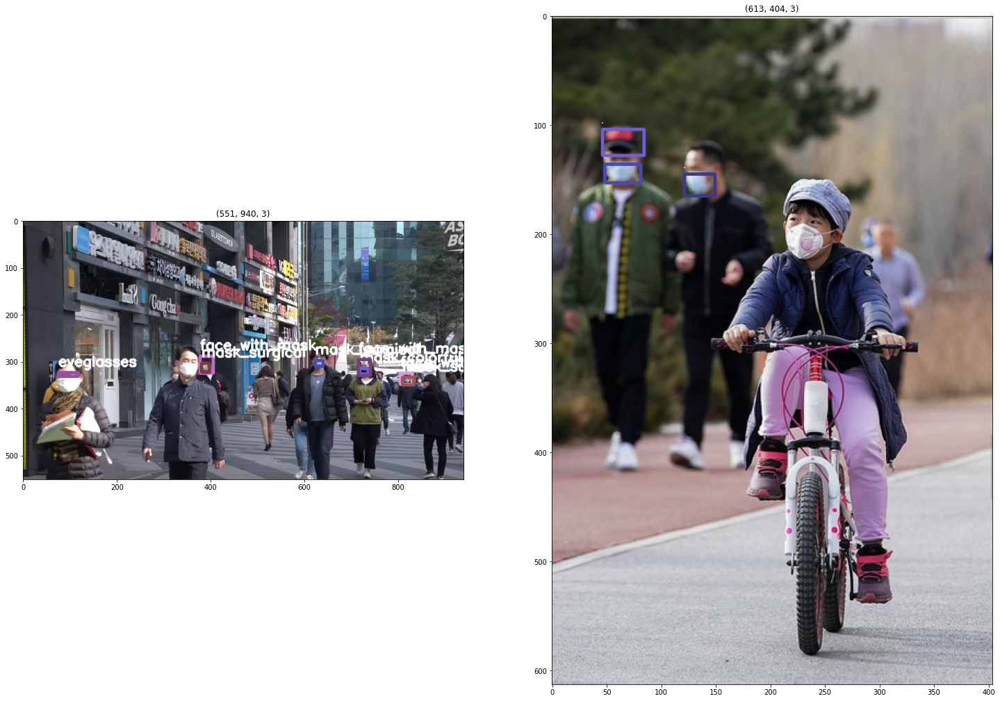

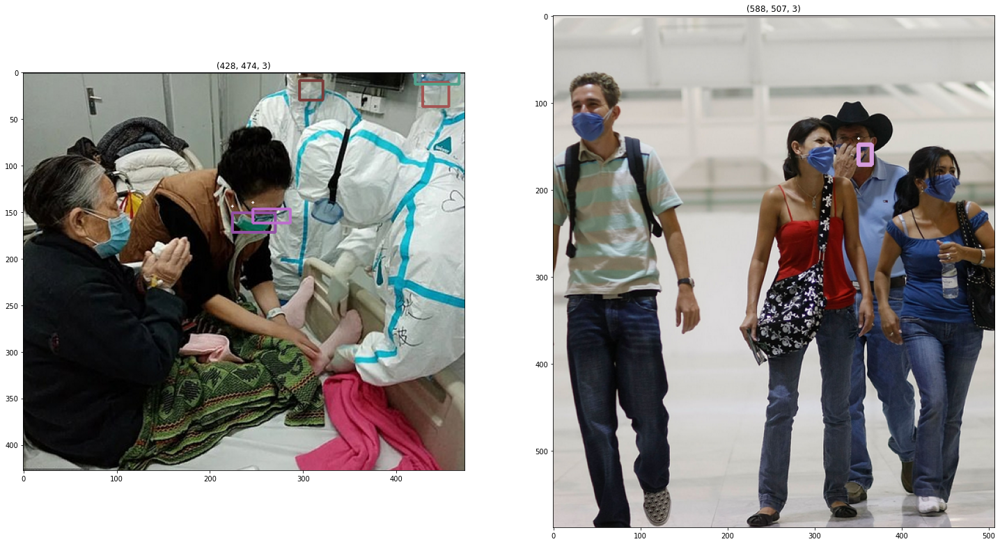

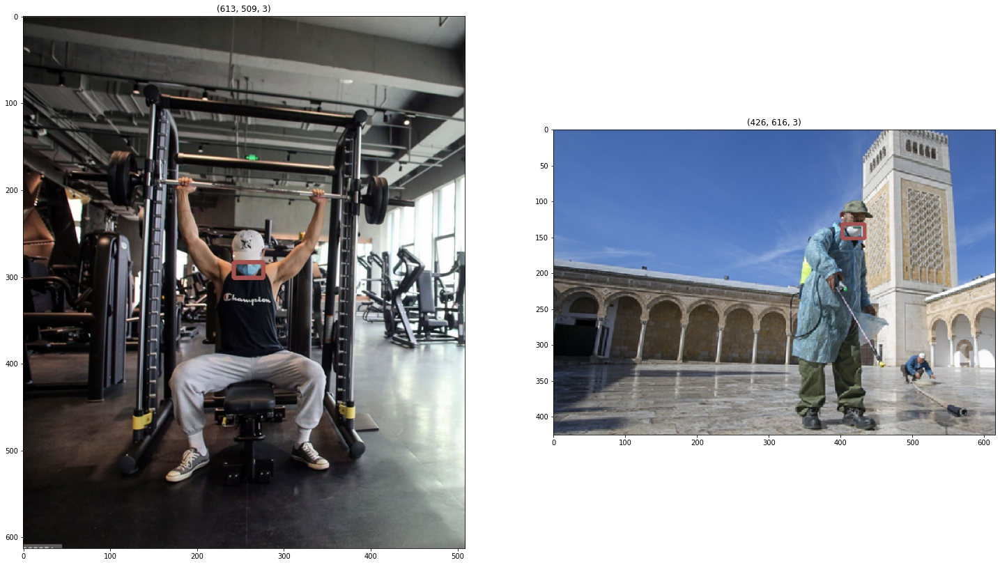

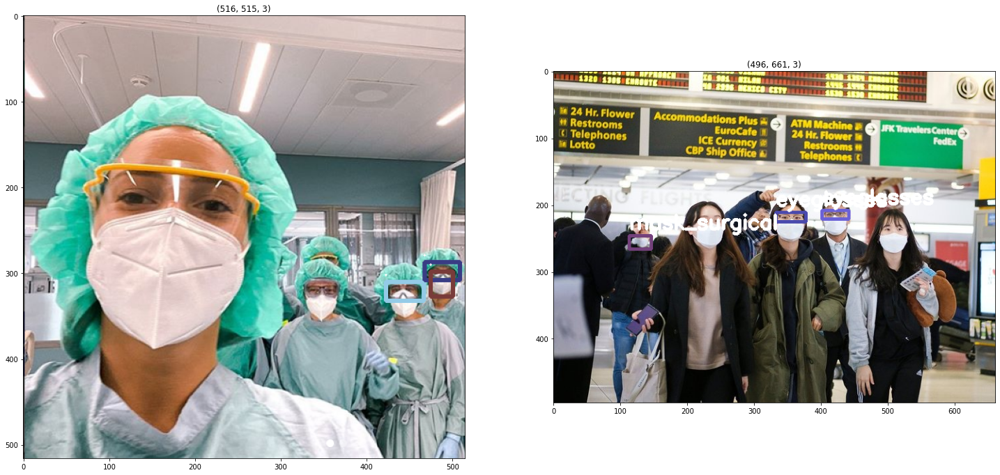

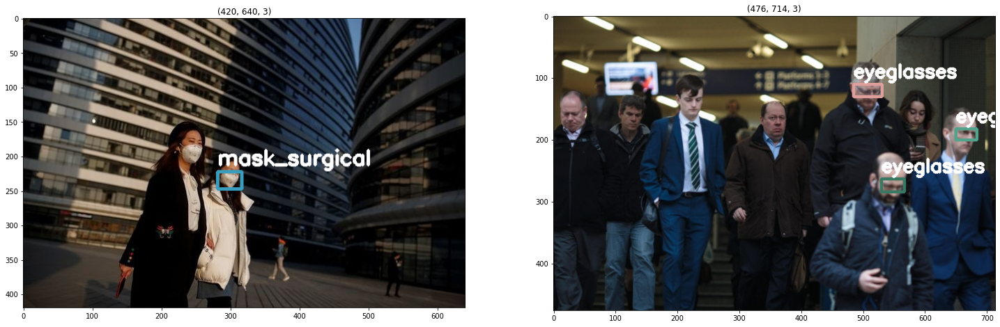

In [ ]:
cols = 2
limit = 50

cmap = plt.get_cmap('tab20b')
colors = [cmap(i) for i in np.linspace(0, 1, 20)]

small_objects_df = dataset_df[dataset_df['area'] < 32 * 32][:limit]
small_objects_grouped = grouper(small_objects_df.groupby('filename'), n=2)

for _, grouped_pairs in enumerate(small_objects_grouped):
    figure, ax = plt.subplots(nrows = 1, ncols = cols, figsize = (25, 25))

    for ind, current_sample in enumerate(grouped_pairs):
        if not current_sample:
            break
        
        (imagename, sample) = current_sample
        image = cv2.imread(
            os.path.join(images_path, imagename)
        )

        for i, row in sample.iterrows():
            color = colors[int(i) % len(colors)]
            color = [i * 255 for i in color]
            
            coordinates = [
                (row['BoundingBox'][0], row['BoundingBox'][1]),
                (row['BoundingBox'][2], row['BoundingBox'][3]),
            ]
                          
            cv2.rectangle(image, coordinates[0], coordinates[1], color, int(4*image.shape[1]/640))
            cv2.putText(image, row['classname'], 
                        (coordinates[0][0], coordinates[0][1] - int(10*image.shape[1]/640)), cv2.FONT_HERSHEY_SIMPLEX, 
                        int(1*image.shape[1]/640), (255,255,255), int(3*image.shape[1]/640))

        ax[ind].set_title(image.shape)
        ax[ind].imshow(image[:,:,::-1])

# Further pre-processing

As we can see there are boxes with very small areas or close to 0. We can just clear these samples out of the dataset and perform pre-processing.

In [ ]:
dataset_df[dataset_df['area'] < 8*8]

,filename,isProtected,ID,BoundingBox,classname,Confidence,Attributes,area,box_ratio
3163,1044.jpg,False,191250884500735360,"[232, 101, 232, 101]",face_with_mask,1,{},0,0.000000
8339,0202.jpg,False,23964555746425976,"[250, 21, 250, 21]",face_with_mask,1,{},0,0.000000
8402,3893.png,False,291948740077704640,"[623, 39, 631, 46]",mask_colorful,1,{},56,1.142857
8403,3893.png,False,661424870692102272,"[660, 43, 667, 50]",mask_colorful,1,{},49,1.000000
9017,1861.jpg,False,211797538039653280,"[582, 126, 582, 126]",face_with_mask_incorrect,1,{},0,0.000000
13069,0291.jpg,False,931099688457294592,"[174, 18, 174, 18]",face_with_mask,1,{},0,0.000000
14800,3983.png,False,401566435136805696,"[343, 139, 350, 145]",mask_colorful,1,{},42,1.166667
15002,0921.jpg,False,528585589077885696,"[28, 112, 28, 112]",face_no_mask,1,{},0,0.000000
15063,0268.jpg,False,431942937244235968,"[603, 23, 603, 23]",face_with_mask,1,{},0,0.000000
15770,2750.png,False,697399018729858048,"[479, 233, 486, 237]",sunglasses,1,{},28,1.750000


As pre-processing, we can use simple resize with inspection of results the results by performing step 2(annotations analysis) and 3(visualization) so we can be sure we didn't break anything in the annotations or images.